In [1]:
import numpy as np
from MieSppForce import dipoles, frenel
import matplotlib.pyplot as plt
from tqdm import tqdm
from scipy.integrate import quad
c_const = 299792458

def get_intencity(wl, P,M, eps_Au):
    px,py,pz = P
    mx, my,mz = M
    ka = -1j*np.sqrt(1/(eps_Au(wl)+1))
    kspp = np.sqrt(eps_Au(wl)/(eps_Au(wl)+1))
    return lambda phi:  np.abs((mx/c_const+1j*ka*py)*np.sin(phi) + (my/c_const - 1j*ka*px)*np.cos(phi) - kspp*pz)**2


    
eps_Si = frenel.get_interpolate('Si')
eps_Au = frenel.get_interpolate('Au')

In [12]:
data = np.load("optimize_spp_f.npz", allow_pickle=True)
Ds = data["Ds"]
params = data["params"]
dipoles_p = data["dipoles_p"]
dipoles_m = data["dipoles_m"]
angles = data["angles"]



# fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
# ax.plot(angles, Ds)
# ax.grid(True)
# plt.xlabel("Угол (радианы)")
# plt.ylabel("D")
# ax.set_title("Максимальные значения D для углов")
# plt.show()

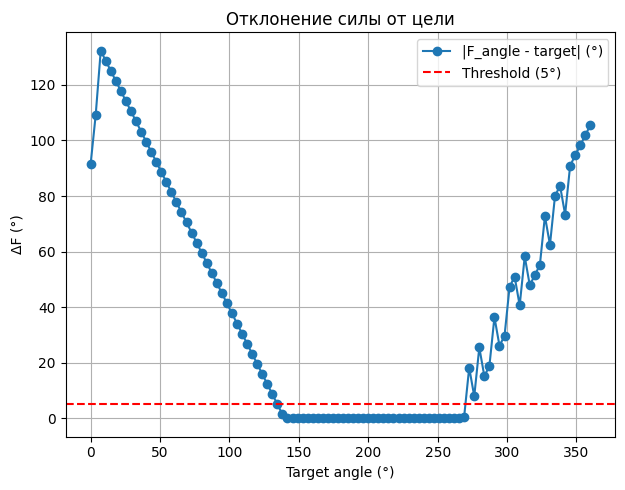

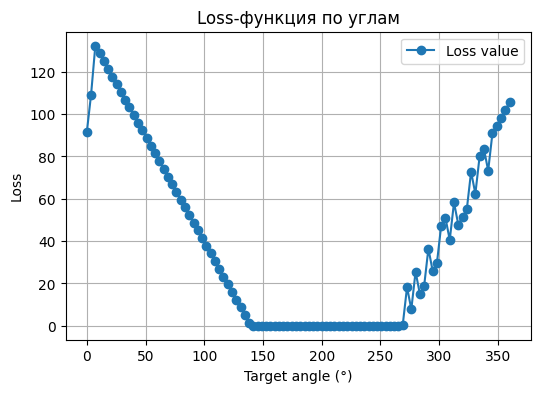

In [37]:

import numpy as np
import matplotlib.pyplot as plt

# Загрузка данных
data = np.load("opt_only_forve_v3.npz")

params = data["params"]
angles = data["angles"]
angle_F = np.unwrap(data["angle_F"])
#angle_D = np.unwrap(data["angle_D"])
losses = np.unwrap(data["losses"])
delta_F = np.unwrap(data["delta_F"])
#delta_DF = np.unwrap(data["delta_DF"])

# --- Угловые ошибки ---
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.plot(np.degrees(angles), np.degrees(delta_F), 'o-', label='|F_angle - target| (°)')
plt.axhline(5, color='r', linestyle='--', label='Threshold (5°)')
plt.xlabel("Target angle (°)")
plt.ylabel("ΔF (°)")
plt.title("Отклонение силы от цели")
plt.legend()
plt.grid(True)

# plt.subplot(1, 2, 2)
# plt.plot(np.degrees(angles), np.degrees(delta_DF), 'o-', label='|F_angle - D_angle| deviation from 180° (°)')
# plt.axhline( 170, color='r', linestyle='--', label='Threshold (10°)')
# plt.axhline( 190, color='r', linestyle='--')
# plt.xlabel("Target angle (°)")
# plt.ylabel("Deviation from opposite (°)")
# plt.title("Отклонение силы от противоположного интенсивности")
# plt.legend()
# plt.grid(True)

plt.tight_layout()
plt.show()

# --- Лосс-функция ---
plt.figure(figsize=(6, 4))
plt.plot(np.degrees(angles), np.degrees(losses), 'o-', label='Loss value')
plt.xlabel("Target angle (°)")
plt.ylabel("Loss")
plt.title("Loss-функция по углам")
plt.grid(True)
plt.legend()
plt.show()


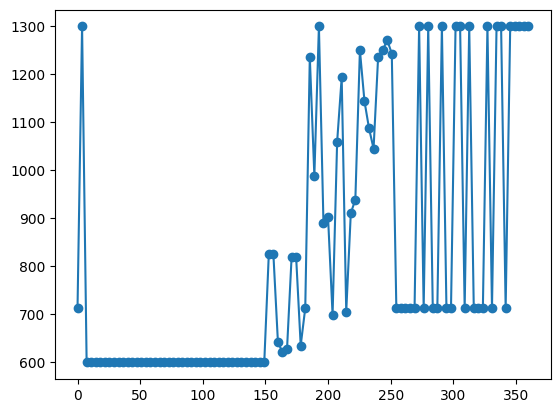

In [41]:
plt.plot(np.degrees(angles), params[:,0], 'o-')

In [14]:
def get_directivity(wl, P,M, eps_Au):
    px,py,pz = P
    mx, my,mz = M
    ka = -1j*np.sqrt(1/(eps_Au(wl)+1))
    kspp = np.sqrt(eps_Au(wl)/(eps_Au(wl)+1))
    I = lambda phi:  np.abs((mx/c_const+1j*ka*py)*np.sin(phi) + (my/c_const - 1j*ka*px)*np.cos(phi) - kspp*pz)**2
    Imax = quad(I, 0, 2 * np.pi)[0]
    return  lambda phi: 2 * np.pi * I(phi) / Imax

In [42]:
# Перезапуск ядра: необходимо повторно загрузить библиотеки и выполнить код заново
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from MieSppForce import frenel, dipoles, force
from scipy.integrate import quad
from scipy.optimize import minimize_scalar

# === Загрузка сохраненных параметров оптимизации ===
data = np.load("optimize_no_spp_dir_600_900.npz")
params = data["params"]  # [wavelength, phi, a_angle]
angles = data["angles"]
losses = data["losses"]

# === Константы ===
c_const = 299792458
STOP = 45
R = 110
dist = 2
point = [0, 0, dist + R]
ANGLE = 25 * np.pi / 180

# === Материалы ===
eps_Si = frenel.get_interpolate('Si')
eps_Au = frenel.get_interpolate('Au')


# === Подготовка данных для визуализации ===
phi_grid = np.linspace(-np.pi, np.pi, 300)
intensity_map = []
angles_F = []

F_x_params = np.zeros((len(params), 8))
F_y_params = np.zeros((len(params), 8))
F_z_params = np.zeros((len(params), 8))

for i, (wl, phi, a_angle) in enumerate(params):
    p, m = dipoles.calc_dipoles_v2(wl, eps_Au, point, R, eps_Si, ANGLE,
                                   amplitude=1, phase=phi, a_angle=a_angle, stop=STOP)
    f = force.F(wl, eps_Au, point, R, eps_Si, ANGLE,
                amplitude=1, phase=phi, a_angle=a_angle, stop=STOP, full_output=True)
    F_x_params[i] = f[0]
    F_y_params[i] = f[1]
    F_z_params[i] = f[2]
    angle_F = np.arctan2(F_y_params[i,0], F_x_params[i,0] - F_x_params[i,1] - F_x_params[i,4])
    angles_F.append(angle_F)

    p, m = p[:, 0], m[:, 0]
    directivity_fn = get_directivity(wl, p, m, eps_Au)
    intensity_vals = np.array([directivity_fn(phi) for phi in phi_grid])
    intensity_map.append(intensity_vals)

intensity_map = np.array(intensity_map)
angles_F = np.array(angles_F)



c:\Users\borod\Desktop\SPP_ANALYTICAL\SPP_ANALYTICAL\.venv\Lib\site-packages\scipy\integrate\_quadpack_py.py:444: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  im_retval = quad(imfunc, a, b, args, full_output, epsabs,
c:\Users\borod\Desktop\SPP_ANALYTICAL\SPP_ANALYTICAL\.venv\Lib\site-packages\scipy\integrate\_quadpack_py.py:441: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  re_retval = quad(refunc, a, b, args, full_output, epsabs,


In [50]:
f0 = force.F(wl, 1, [0,0,0], R, eps_Si, 0,
                amplitude=1, phase=0, a_angle=0, stop=STOP, full_output=False)[2]

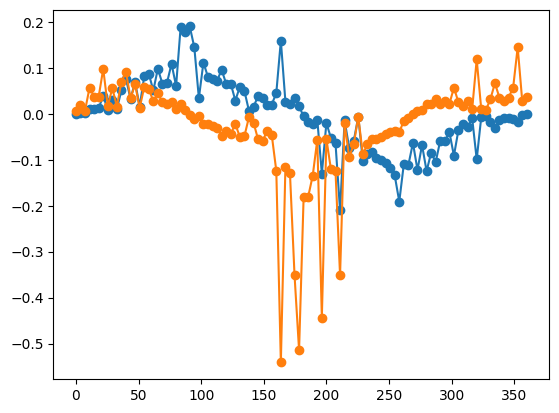

In [54]:
plt.plot(np.degrees(angles), F_y_params[:,0]/np.abs(f0), 'o-')
plt.plot(np.degrees(angles), (F_x_params[:,0]-F_x_params[:,1]-F_x_params[:,4])/np.abs(f0), 'o-')

<>:17: SyntaxWarning: invalid escape sequence '\l'
<>:17: SyntaxWarning: invalid escape sequence '\d'
<>:17: SyntaxWarning: invalid escape sequence '\l'
<>:17: SyntaxWarning: invalid escape sequence '\d'
C:\Users\borod\AppData\Local\Temp\ipykernel_5032\3158902438.py:17: SyntaxWarning: invalid escape sequence '\l'
  ax.set_title(f'R={R} nm, $\lambda=${round(params[ind,0],1)}, $\\beta$={round(params[ind,1],2)}, $\delta \\varphi=${round(params[ind,2],2)}', fontsize=14, fontweight='bold', pad=20)
C:\Users\borod\AppData\Local\Temp\ipykernel_5032\3158902438.py:17: SyntaxWarning: invalid escape sequence '\d'
  ax.set_title(f'R={R} nm, $\lambda=${round(params[ind,0],1)}, $\\beta$={round(params[ind,1],2)}, $\delta \\varphi=${round(params[ind,2],2)}', fontsize=14, fontweight='bold', pad=20)


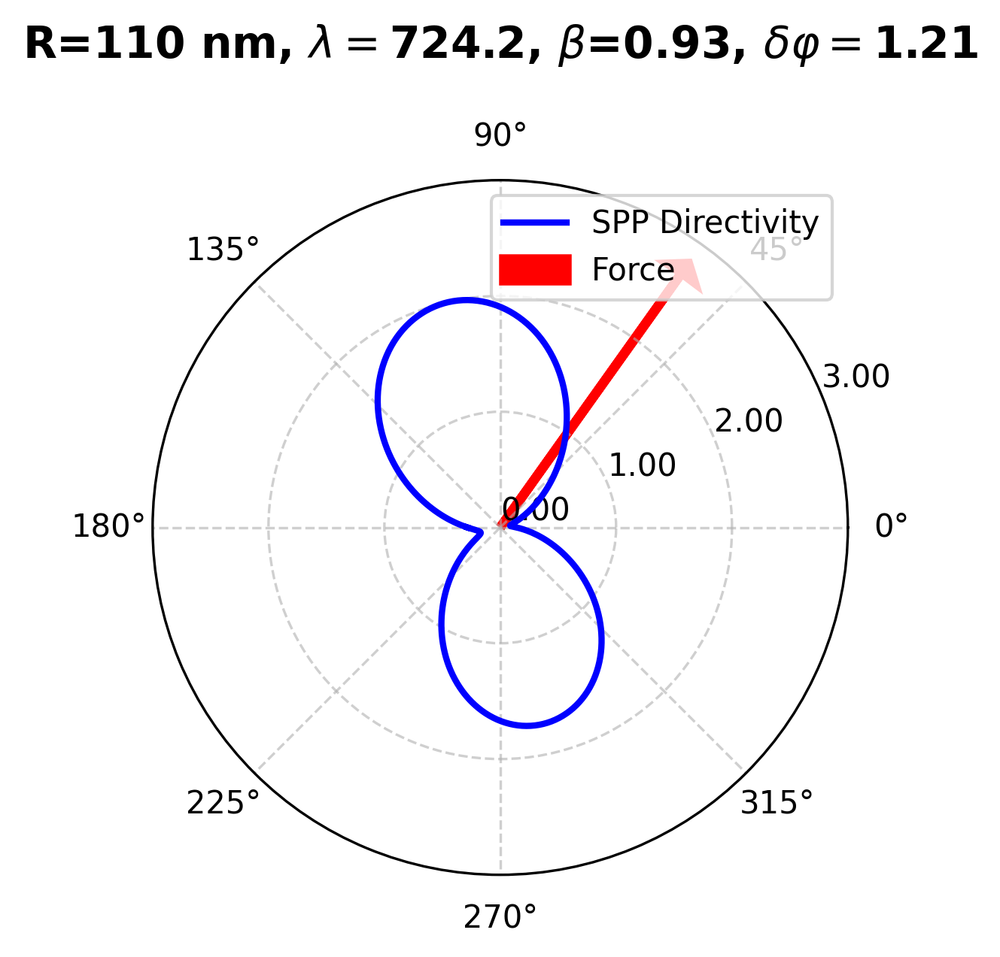

In [55]:
import numpy as np
import matplotlib.pyplot as plt

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, dpi=300, figsize=(5, 4))
ind = 15

ax.plot(phi_grid, intensity_map[ind], label='SPP Directivity', color='blue', linewidth=2) 
ax.arrow(angles_F[ind], 0, 0, 2.8, 
         color='red', linewidth=3, head_width=0.1, head_length=0.1, length_includes_head=True, label='Force')

# ax.arrow(phi_max, 0, 0, D_max*0.8 , 
#          color='green', linewidth=3, head_width=0.1, head_length=0.1, length_includes_head=True, label='Max Directivity')

ax.set_rticks([0, 1, 2, 3])  
ax.set_yticklabels([f"{0:.2f}", f"{1:.2f}", f"{2:.2f}", f"{3:.2f}"], fontsize=10)

ax.set_title(f'R={R} nm, $\lambda=${round(params[ind,0],1)}, $\\beta$={round(params[ind,1],2)}, $\delta \\varphi=${round(params[ind,2],2)}', fontsize=14, fontweight='bold', pad=20)
ax.grid(True, linestyle='--', alpha=0.6)
ax.legend(loc='upper right')

plt.show()


<>:25: SyntaxWarning: invalid escape sequence '\l'
<>:25: SyntaxWarning: invalid escape sequence '\d'
<>:25: SyntaxWarning: invalid escape sequence '\l'
<>:25: SyntaxWarning: invalid escape sequence '\d'
C:\Users\borod\AppData\Local\Temp\ipykernel_5032\1227768755.py:25: SyntaxWarning: invalid escape sequence '\l'
  ax.set_title(f'R={R} nm,\n $\lambda=${round(params[ind,0],1)}, $\\beta$={round(params[ind,1],2)}, $\delta \\varphi=${round(params[ind,2],2)}', fontsize=14, fontweight='bold', pad=20)
C:\Users\borod\AppData\Local\Temp\ipykernel_5032\1227768755.py:25: SyntaxWarning: invalid escape sequence '\d'
  ax.set_title(f'R={R} nm,\n $\lambda=${round(params[ind,0],1)}, $\\beta$={round(params[ind,1],2)}, $\delta \\varphi=${round(params[ind,2],2)}', fontsize=14, fontweight='bold', pad=20)
MovieWriter ffmpeg unavailable; using Pillow instead.
Animation size has reached 21213410 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.e

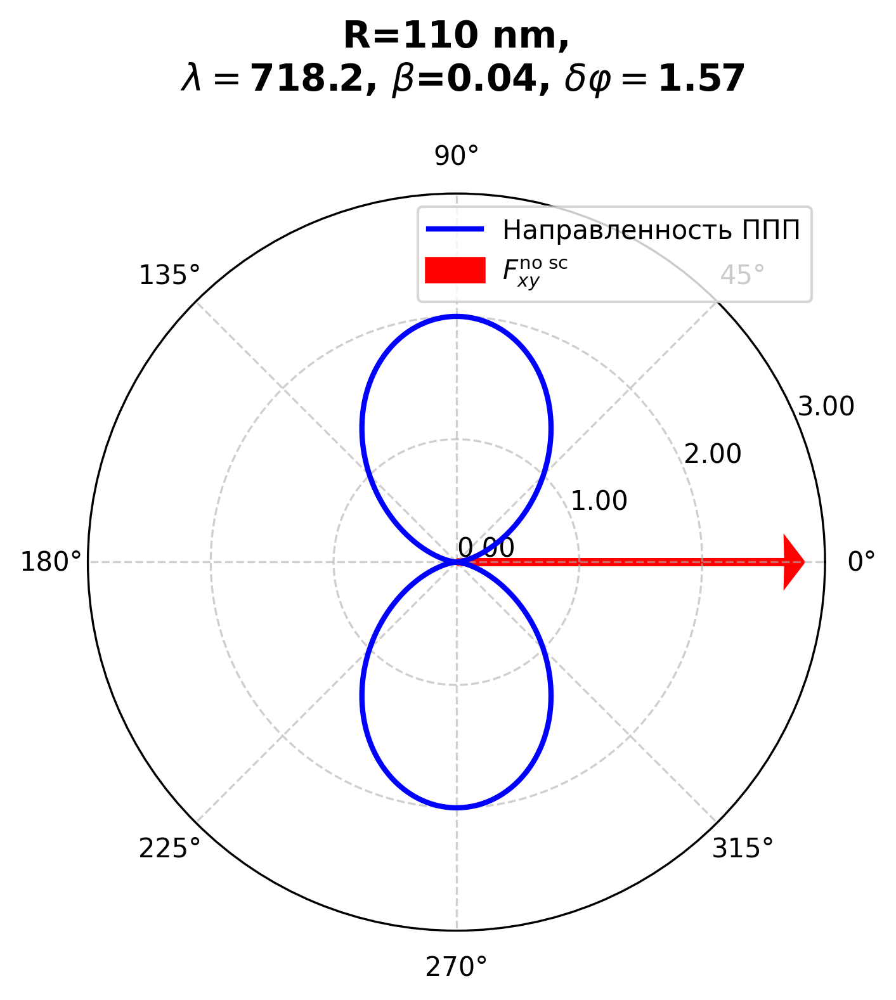

In [65]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import display, HTML
import os
from IPython.display import HTML

# Создаем фигуру и оси
fig, ax = plt.subplots(figsize=(5, 6), subplot_kw={'projection': 'polar'}, dpi=300)  # Квадратный размер

# Функция обновления кадров
def update(ind):
    ax.cla()  # Очищаем оси перед обновлением

    ax.plot(phi_grid, intensity_map[ind], label='Направленность ППП', color='blue', linewidth=2) 
    ax.arrow(angles_F[ind], 0, 0, 2.8, 
            color='red', linewidth=3, head_width=0.1, head_length=0.1, length_includes_head=True, label='$F_{xy}^{\\text{no sc}}$')



    # Настройки радиальных меток
    ax.set_rticks([0, 1, 2, 3])
    ax.set_yticklabels([f"{0:.2f}", f"{1:.2f}", f"{2:.2f}", f"{3:.2f}"], fontsize=10)

    ax.set_title(f'R={R} nm,\n $\lambda=${round(params[ind,0],1)}, $\\beta$={round(params[ind,1],2)}, $\delta \\varphi=${round(params[ind,2],2)}', fontsize=14, fontweight='bold', pad=20)
    ax.grid(True, linestyle='--', alpha=0.6)
    ax.legend(loc='upper right')

# Количество кадров (по количеству индексов)
num_frames = len(params[:,0])

# Создание анимации
ani = animation.FuncAnimation(fig, update, frames=num_frames, interval=200)  # Увеличен interval для плавности

# Сохранение в GIF с уменьшенной скоростью
gif_path = f"force_from_param.gif"
ani.save(gif_path, fps=5)  # fps=5 делает анимацию в 2 раза медленнее
HTML(ani.to_jshtml())



In [32]:
f0 = force.F(800, 1, [0,0,0], 110, eps_Si, 0,
                            amplitude=1, phase=0, a_angle=0, stop=STOP, full_output=False)
                

In [34]:
f0[2]

np.float64(-1.0721990233287847e-24)